<div style="background:#FFFFEE; color:#440404; padding:8px; border-radius: 4px; text-align: center; font-weight: 500;">IFN619 - Data Analytics for Strategic Decision Makers (2023_sem1)</div>

# IFN619 :: Assignment 2 :: Extending Analytics (40%)

**IMPORTANT:** Refer to the instructions in Canvas module [About the Assessment - Assignment 2](https://canvas.qut.edu.au/courses/2159/pages/instructions-for-extending-analytics-assignment?module_item_id=1170253) *BEFORE* working on this assignment.

1. Complete and run the code cell below to display your name, student number, and assignment option
2. Delete the cells for the option that you are not using
3. Complete a full analysis for your chosen option. Ensure that you include:
    - documentation of your thinking and decision-making
    - clear articulation of ethical considerations and human factors in both your analysis choices and your insights
    - at least one extended analysis approach (unstructured data analytics, ehanced visualisation, machine learning techniques)
4. Submit your final notebook on Canvas [Assignment 2 submission page](https://canvas.qut.edu.au/courses/2159/assignments/127215)


In [79]:
# Complete the following cell with your details and run to produce your personalised header for this assignment

from IPython.display import HTML

# personal details
first_name = 'Ta-Chun'
last_name = 'Lin'
student_number = '11169575'
# assignment option
option_choice = 'own choice of analysis' # either "extending assign 1" OR "own choice of analysis"

personal_header = f"<h1>{first_name} {last_name} ({student_number}) :: Option: {option_choice}</h1>"
HTML(personal_header)

---
### Option 2 - own choice of analysis

You may choose your own scenario and your own data source. However, you **must** provide a link to the source of your data, and a good description of it. You should also provide a detailed description of your scenario and why your chosen question/s is/are important.

### The topic to demonstrate: Machine Learning for data analytics

<hr />

## Data Analysis - Airline Passenger Satisfaction

This Data Analysis is going to implement the **QDAVI** approach lifecycle:

**Question**
* The purpose of this analysis, what significant problem/question to be solved.

**Data** 
* The data source used in this analysis came from **Kaggle**: https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction
* The data used in this analysis (**satisfaction.csv**) is the **train.csv** dataset on **Kaggle**.
* Preprocessing.

**Analysis**
* Analyse the data in order to solve the question. You may need to undertake more than one analysis to answer the question.

**Visualisation** 
* Express the analysis using visualisation in order to understand and extract insights from it.

**Insights**
* Find the insights and solutions that answer the question of concern.

<hr />

**Note**

* **Ethical Considerations** and **Assumptions** will be declared on **Analysis** and **Visualisation** part of the cycle.

<hr />

## Question

<hr />

**Scenario**

I am working at an airline company, and our company is trying to increase the airline passenger satisfaction in order to boost the market share and be more competitive among other companies. 

Our company believes that customer service is always one of the top key that determines if the passengers are satisfied with our service provided. 

I was given a task to analyse the service provided by our company, which requires me to extract the facts and information that impacts the satisfaction of the passengers. Upon doing so, provide a plausible recommendation(s) to help the company to improve the passenger satifactions.

Ultimately, it is required for me to build a Machine Learning model to help predict the passenger satisfaction with the services that the passengers received.

<hr />

**Question (Problem Definition)**

* Stakeholder/ Target Audience: Airline company
* Main Purpose: Increase passenger satisfactions

> **Questions**: 

> **1. What are the key factors that significantly impact passenger satisfactions with the services provided by the airline company?**

> **2. Aside of Services provided by the company, identify the main areas that contribute most to the passenger satisfactions**
>    * Membership/Customer Type
        * **Columns:** Customer Type, Gender       
>    * Demographics
        * **Columns:** Age    
>    * Travel Details
        * **Columns:** Class, Flight distance
            * As *Departure Delay* and *Arrival Delay* are unpredictable, therefore, it will not be considered.
            * For *Type of Travel* in terms of either Personal or Business, it will be excluded as services provided by the company are the same regardless.
    
**Why the questions are significant?**
* They are significant as by analyzing the key factors that impact passenger satisfaction, it allows me to identify on the specific areas where improvements can be done. By pinpointing these factors, the company can allocate resources and prioritize efforts to enhance the overall passenger experience.

<hr />

## Data

<hr />

**Airline Passenger Satisfaction Data**
* The data source used in this analysis came from **Kaggle**: https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction
* The data used in this analysis (**satisfaction.csv**) is the **train.csv** dataset on **Kaggle**.

**Data Assumption**
* The data is from the same **airline company**, as there is a column `Customer Type` which denotes **loyal customer** and **disloyal customer**.

<hr />

### Data Description

**Gender:** Gender of the passengers (Female, Male)

**Customer Type:** The customer type (Loyal customer, disloyal customer)

**Age:** The actual age of the passengers

**Type of Travel:** Purpose of the flight of the passengers (Personal Travel, Business Travel)

**Class:** Travel class in the plane of the passengers (Business, Eco, Eco Plus)

**Flight distance:** The flight distance of this journey

**Inflight wifi service:** Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

**Departure/Arrival time convenient:** Satisfaction level of Departure/Arrival time convenient

**Ease of Online booking:** Satisfaction level of online booking

**Gate location:** Satisfaction level of Gate location

**Food and drink:** Satisfaction level of Food and drink

**Online boarding:** Satisfaction level of online boarding

**Seat comfort:** Satisfaction level of Seat comfort

**Inflight entertainment:** Satisfaction level of inflight entertainment

**On-board service:** Satisfaction level of On-board service

**Leg room service:** Satisfaction level of Leg room service

**Baggage handling:** Satisfaction level of baggage handling

**Check-in service:** Satisfaction level of Check-in service

**Inflight service:** Satisfaction level of inflight service

**Cleanliness:** Satisfaction level of Cleanliness

**Departure Delay in Minutes:** Minutes delayed when departure

**Arrival Delay in Minutes:** Minutes delayed when Arrival

**Satisfaction:** Airline satisfaction level(Satisfaction, neutral or dissatisfaction)

<hr />

### Data Imports

In [80]:
import numpy as np
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots

In [81]:
df = pd.read_csv('data/satisfaction.csv', index_col=[0])
df.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4.0,5.0,5.0,25.0,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1.0,4.0,1.0,1.0,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4.0,4.0,5.0,0.0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1.0,4.0,2.0,11.0,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3.0,3.0,3.0,0.0,0.0,satisfied


In [82]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71549 entries, 0 to 71548
Data columns (total 24 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   id                                 71549 non-null  int64  
 1   Gender                             71549 non-null  object 
 2   Customer Type                      71549 non-null  object 
 3   Age                                71549 non-null  int64  
 4   Type of Travel                     71549 non-null  object 
 5   Class                              71549 non-null  object 
 6   Flight Distance                    71549 non-null  int64  
 7   Inflight wifi service              71549 non-null  int64  
 8   Departure/Arrival time convenient  71549 non-null  int64  
 9   Ease of Online booking             71549 non-null  int64  
 10  Gate location                      71549 non-null  int64  
 11  Food and drink                     71549 non-null  int

### Data Preprocessing

**Missing values**

In [83]:
df.isna().sum()

id                                     0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        1
Inflight service                       1
Cleanliness                            1
Departure Delay in Minutes             1
Arrival Delay in Minutes             220
satisfaction                           1
dtype: int64

In [84]:
df.shape

(71549, 24)

There are missing values in `Checkin service`, `Inflight service`, `Cleanliness`, `Departure Delay in Minutes`, `satisfaction`

In [85]:
df[df.iloc[:, 18:24].isnull().all(axis=1)]

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
71548,63781,Female,Loyal Customer,44,Business travel,Eco,1721,3,2,5,...,4,4,3,4,NaN,NaN,NaN,NaN,NaN,NaN


After investigation, the 1 missing values in `Checkin service`, `Inflight service`, `Cleanliness`, `Departure Delay in Minutes`, `satisfaction` are located at the same row.
* As **1 out of 71549** is only 0.0014% of the entire dataset, the best way is to drop the entire row.

In [86]:
df.dropna(subset=['satisfaction'], inplace=True)

Check for missing values of the same row have been addressed

In [87]:
df.isna().sum()

id                                     0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             219
satisfaction                           0
dtype: int64

The column with empty values are `Arrival Delay in Minutes`, a total of 219 missing values.
* As this column is a numerical column, first investigate the **distribution and skewness** before deciding to fill the values with **mean or median**.

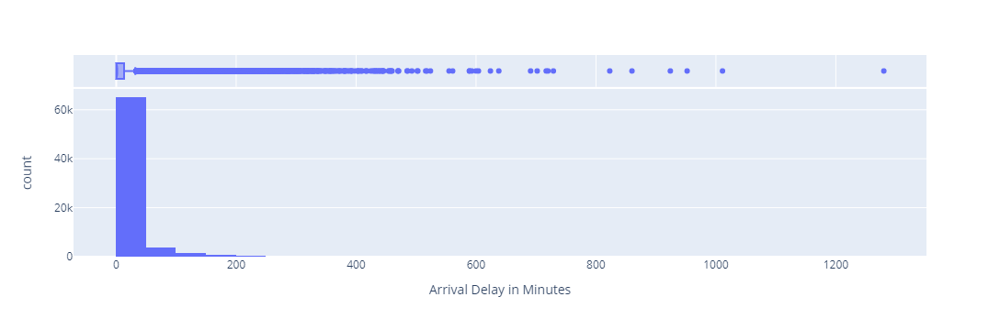

In [88]:
px.histogram(df, x='Arrival Delay in Minutes', nbins=30, marginal='box')

As **mean** is greatly affected by outliers, **median** will instead be used to replace the missing values for this column.

In [89]:
df['Arrival Delay in Minutes'].fillna(df['Arrival Delay in Minutes'].median(), inplace=True)

Missing values have all be filled

In [90]:
df.isna().sum()

id                                   0
Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Inflight wifi service                0
Departure/Arrival time convenient    0
Ease of Online booking               0
Gate location                        0
Food and drink                       0
Online boarding                      0
Seat comfort                         0
Inflight entertainment               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Inflight service                     0
Cleanliness                          0
Departure Delay in Minutes           0
Arrival Delay in Minutes             0
satisfaction                         0
dtype: int64

**Correcting Datatypes**

In [91]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71548 entries, 0 to 71547
Data columns (total 24 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   id                                 71548 non-null  int64  
 1   Gender                             71548 non-null  object 
 2   Customer Type                      71548 non-null  object 
 3   Age                                71548 non-null  int64  
 4   Type of Travel                     71548 non-null  object 
 5   Class                              71548 non-null  object 
 6   Flight Distance                    71548 non-null  int64  
 7   Inflight wifi service              71548 non-null  int64  
 8   Departure/Arrival time convenient  71548 non-null  int64  
 9   Ease of Online booking             71548 non-null  int64  
 10  Gate location                      71548 non-null  int64  
 11  Food and drink                     71548 non-null  int

By looking into the data and comparing to data description, the following columns required change in datatype:

* **object** to **category**: `Gender`, `Customer Type`, `Type of Travel`, `Class`.

* **float64** to **int64**: `Checkin Service`, `Inflight Service`, `Cleanliness Service`, `Departure Delay in Minutes`, `Arrival Delay in Minutes`

* **object** to **int64**: `satisfaction`


**Note**
* For columns: `Inflight wifi service`, `Departure/Arrival time convenient`, `Ease of Online booking`, `Gate location`, `Food and drink`, `Online boarding`, `Seat comfort`, `Inflight entertainment`, `On-board service`, `Leg room service`, `Baggage handling`, `Checkin service`, `Inflight service`, `Cleanliness`
    * They are **satisfaction level** on a scale of 1 - 5, meaning that they are **not continuous number**. However, they will stay in **int64** datatype for the ease of this analysis.
    
* For column `satisfaction`, it will serve as **target** column at the later part, this column will be transformed into **binary values** in **int64**, with **1 representing satisfied** and **0 representing neutral or dissatisfied**.

In [92]:
df.iloc[:, 1:3] = df.iloc[:, 1:3].astype('category')
df.iloc[:, 4:6] = df.iloc[:, 4:6].astype('category')
df.iloc[:, 18:23] = df.iloc[:, 18:23].astype('int64')

# For target column, satisfaction
satisfaction_map = {'satisfied': 1, 'neutral or dissatisfied': 0}
df['satisfaction'] = df['satisfaction'].map(satisfaction_map)

In [93]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71548 entries, 0 to 71547
Data columns (total 24 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   id                                 71548 non-null  int64   
 1   Gender                             71548 non-null  category
 2   Customer Type                      71548 non-null  category
 3   Age                                71548 non-null  int64   
 4   Type of Travel                     71548 non-null  category
 5   Class                              71548 non-null  category
 6   Flight Distance                    71548 non-null  int64   
 7   Inflight wifi service              71548 non-null  int64   
 8   Departure/Arrival time convenient  71548 non-null  int64   
 9   Ease of Online booking             71548 non-null  int64   
 10  Gate location                      71548 non-null  int64   
 11  Food and drink                     71548 

<hr />

## Analysis

<hr />

### Distribution

Before performing a meaningful analysis, it is important to investigate if the columns that contribute to the passengers' experience have unequal weightage.
* For example, there are significant more male than female, or vice versa, present in the dataset, which might affect the outcome.
* The columns to investigate: `Gender`, `Customer Type`, `Age`, `Class`, `Flight Distance`.
    * These columns are **assumed** to be the main contributors to other flight-experiences, and ultimately affect the overall satisfaction.

To address this issue, it is **assumed** that all responses are filled in correctly without errors.
* For example, a passenger did not accidentally fill the **Age** column wrongly to another value.

Then, distribution analysis of the stated column will be done to investigate the skewness to understand **if responses are fair**.

In [94]:
# Function to display distributions for multiple columns
def distribution_analysis(cols: list) -> None:
    for col in cols:
        fig = px.histogram(df, x=col, marginal='box')
        fig.show();

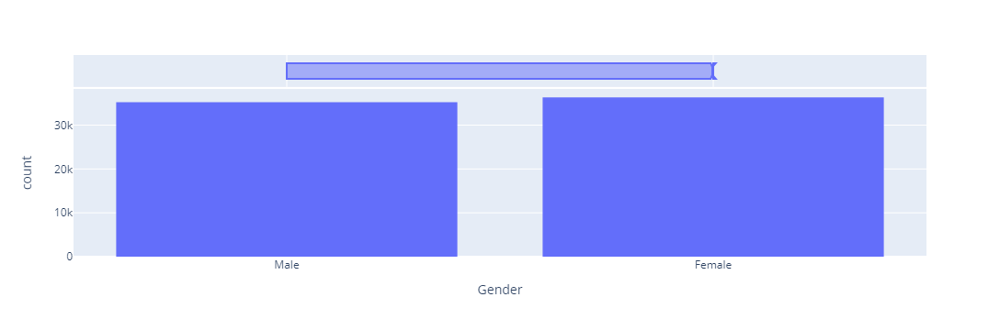

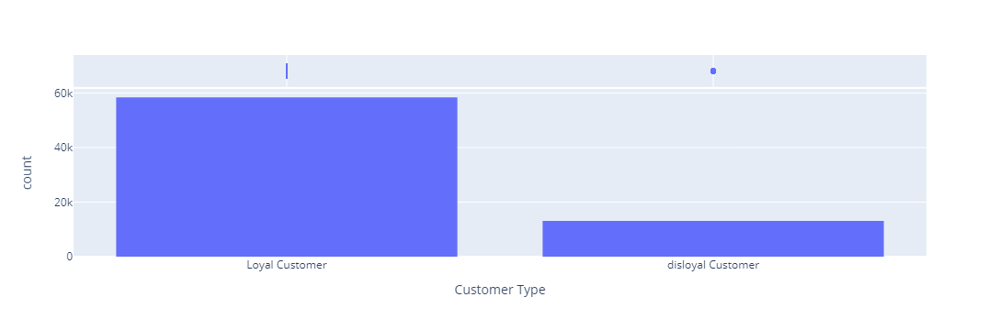

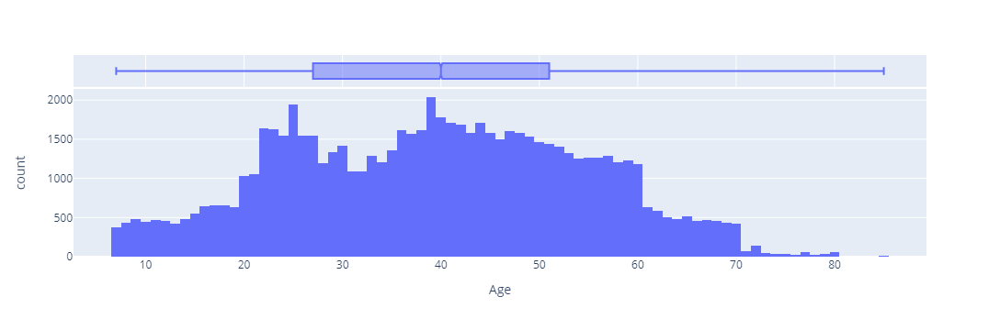

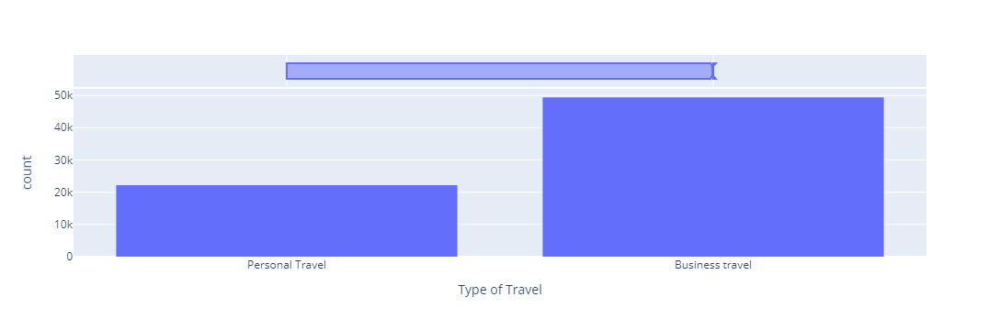

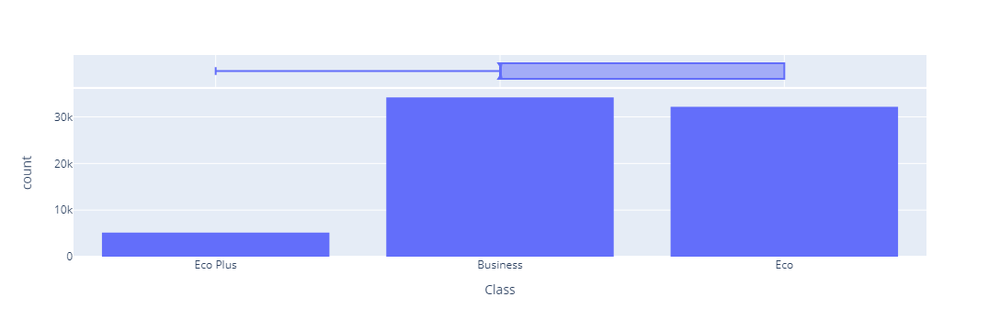

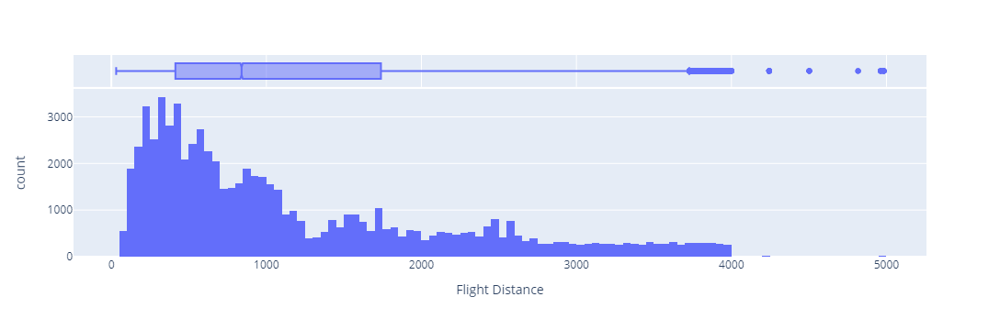

In [95]:
# Get columns from 1 to 6
distribution_analysis(df.iloc[:, 1:7].columns)

From the above distribution:
* There is equal distribution for `Gender`, that is, the number of **male** and **felmale** are approximately equal in this responses.
    * No `Gender` biases
    
    
* For `Customer Type`, there are significantly **more loyal customers** than disloyal customers.
    * This might cause the dataset to be **biased**, thus, contributing to the overall satisfaction rate.
    * Loyal customers are the customers who frequently fly with our flight company, meaning that they are **potentially more satisfied** overall.
        * This will be further investigated when comparing to `satisfaction` column.
        
* For `Age`, the majority of the responses are gathered from between the age of 20 - 60.
    * It will require investigation to see **if age range affects satisfaction** to avoid biases.
    
* For `Type of Travel`, majority of the responses are under **business travel**
    * Generally, business travel does not require each response to pay for their own flight.
    * It will be interesting to see if **business travel** has more satisfaction, and the **class** that they are flying.
    
* For `Flight Distance`, majority of the responses fly a rather shorter distance (less than 1000 kms).
    * As the longer that a person sits on the plane, the more uncomfortable that they will become.
    * However, this might not be the same for the class that each passenger is travelled with.
    * Thus, it will require to investigate the **satisfaction with flight distance** and **the relationship between flight distance, class, satisfaction**.
    

> The main reasons to perform the analysis shown above is to be **as neutral as possible**, that is, **to avoid potential biases**.
> * For example, the majority of the people are loyal customers, they might have a higher likelihood to have **satisfied** as their answers on the survey. This contributes to the **overall satisfaction rate** of the survey.
>    * Without performing these analysis, we might **overestimate** the number of people who are satisfied, as the majority of the people who are satisfied might be from the answers of **loyal customers**.

<hr />

## Visualizations

<hr />

### Overall Satisfaction Rate

In [96]:
# Making a count dataframe for 'satisfaction'
satisfaction_df = df['satisfaction'].replace({0: 'neutral & disatisfied', 1: 'satisfied'}).value_counts().reset_index()
satisfaction_df

,index,satisfaction
0,neutral & disatisfied,40430
1,satisfied,31118


In [97]:
satisfaction_df.columns = ['satisfaction', 'count']
satisfaction_df

,satisfaction,count
0,neutral & disatisfied,40430
1,satisfied,31118


Adding a `percentage` column to make it easier to compare

In [98]:
satisfaction_df['percentage'] = round(satisfaction_df['count'] / satisfaction_df['count'].sum() * 100, 2)
satisfaction_df

,satisfaction,count,percentage
0,neutral & disatisfied,40430,56.51
1,satisfied,31118,43.49


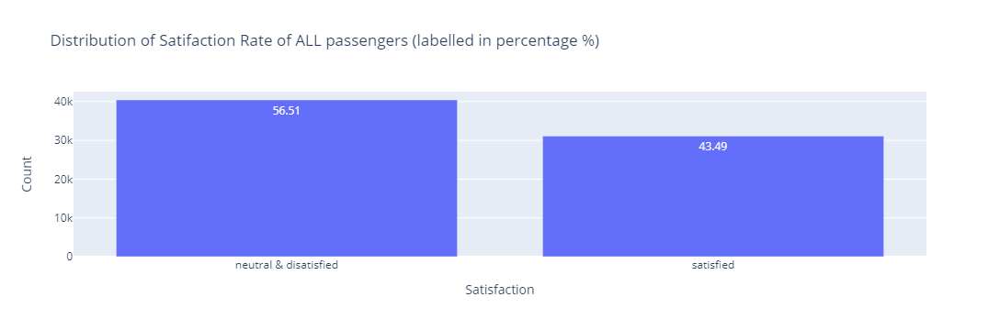

In [99]:
px.bar(satisfaction_df,
       x='satisfaction',
       y='count',
       text='percentage',
       labels={'count': 'Count', 'satisfaction': 'Satisfaction'},
       title='Distribution of Satifaction Rate of ALL passengers (labelled in percentage %)')

From the first glance of the distribution above, it will easily be assumed that **more than half (56.51%)** of the passengers are **disatisfieid**.

However, is it really a **fair comparison?**
* The disatisfaction rate **might be even higher** or **lower**, depending on the **factors mentioned previously**.

To avoid **potential biases**, we need to perform further investigation.

<hr />

### Gender and Satisfaction Rate

As both genders (male and female) are almost equal in quantity, it will be interesting to see if different gender has a different opinion on the services provided.

To plot a **heatmap** showing the comparison, a **confusion matrix** has first to be made
* The portions are converted into **percentages**

In [100]:
gender_cm = round(pd.crosstab(df['Gender'], df['satisfaction'], normalize='index') * 100, 2)
gender_cm

satisfaction,0,1
Gender,,
Female,57.33,42.67
Male,55.66,44.34


Visualizing the effect of **Gender** on **Satisfaction Rate**

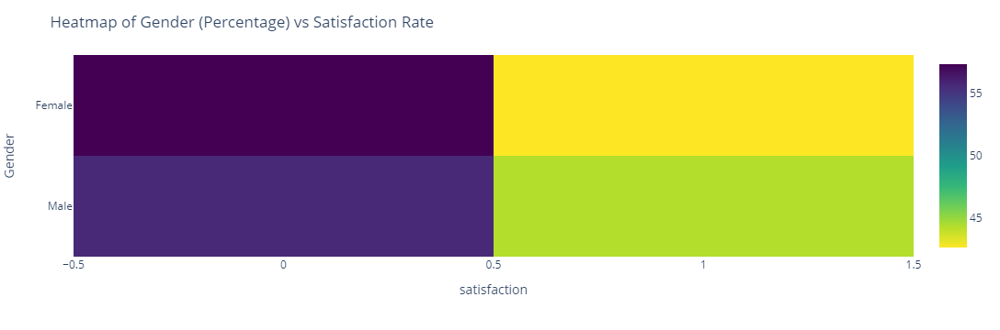

In [101]:
gender_heatmap = px.imshow(gender_cm, color_continuous_scale="Viridis_r")
gender_heatmap.update_layout(title="Heatmap of Gender (Percentage) vs Satisfaction Rate")

The above heatmap implies that **Gender** has no huge impact on the satisfaction rate as both genders have similar satisfaction rate.
* In terms of the the difference in percentage between people who are **satisfied** and **neutral/disatisfied** of each gender, there is no significant difference.
* This may serve as a hint that the services provide by the flight company has not made people of different gender feel differently.
* Thus, **Gender** will not be a factor to be considered when trying to improve the servies to improve the satisfaction rate.

<hr />

### Customer Type and Satisfaction Rate


* Does **Loyal Cusomter** and **Disloyal Customer** has an effect on **satisfaction rate**?

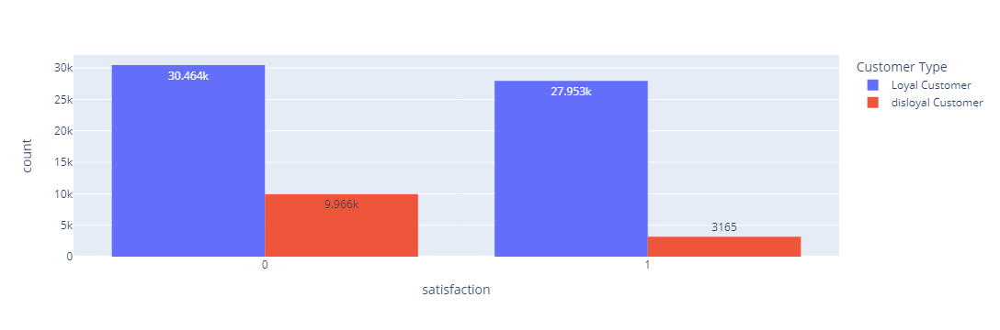

In [102]:
px.histogram(
    df[['satisfaction', 'Customer Type']], 
    x='satisfaction', 
    barmode='group',
    text_auto=True,
    color='Customer Type')

From the plot above, with **0** denoting **neutral/disatisfied** and **1** denoting **satisfied**: 
* It can be seen that comparing to **disloyal customers**, **loyal customers** have a higher tendency to be satisfied with the service.

**However**, the graph above alone is not enough to fulfill the justification, as the majority of the responses are from **loyal customers**.
* The number of **loyal customers** who participated in answering the survey is **significantly larger**.
> To make the comparison **more fair**, it will require to further compare the **percentage** of satisfaction and neutral/disatisfied for **each customer type**.

**Loyal Customers / Disloyal Customers in Percentage and Satisfaction Rate**

Make a dataframe to identify the satisfaction of **loyal customers**

In [103]:
loyal_df = df[df['Customer Type'] == 'Loyal Customer']['satisfaction'].replace({0: 'neutral & disatisfied', 1: 'satisfied'}).value_counts().reset_index()
loyal_df.columns = ['satisfaction', 'count']
loyal_df['percentage'] = round(loyal_df['count'] / loyal_df['count'].sum() * 100, 2)
loyal_df.head()

,satisfaction,count,percentage
0,neutral & disatisfied,30464,52.15
1,satisfied,27953,47.85


Make a dataframe to identify the satisfaction of **disloyal customers**

In [104]:
disloyal_df = df[df['Customer Type'] == 'disloyal Customer']['satisfaction'].replace({0: 'neutral & disatisfied', 1: 'satisfied'}).value_counts().reset_index()
disloyal_df.columns = ['satisfaction', 'count']
disloyal_df['percentage'] = round(disloyal_df['count'] / disloyal_df['count'].sum() * 100, 2)
disloyal_df.head()

,satisfaction,count,percentage
0,neutral & disatisfied,9966,75.9
1,satisfied,3165,24.1


Visualization of **Loyal Customers / Disloyal Customers and Satisfaction Rate**

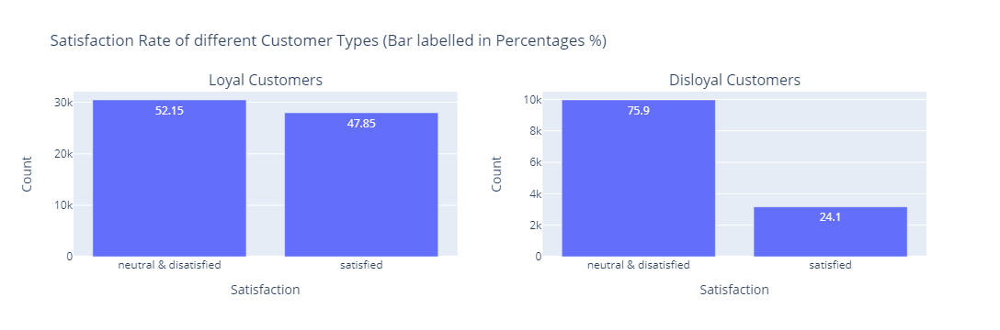

In [105]:
def make_loyal_bar(df:pd.DataFrame, is_loyal) -> px.bar:
    return px.bar(df,
                  x='satisfaction',
                  y='count',
                  text='percentage',
                  labels={'count': 'Count', 'satisfaction': 'Satisfaction'},
                  title=f'Distribution of Satifaction Rate of {"Loyal" if is_loyal else "Disloyal"} Customers (labelled in percentage %)')
    
fig = make_subplots(rows=1, cols=2, subplot_titles=("Loyal Customers", "Disloyal Customers"))

loyal_bar = make_loyal_bar(loyal_df, True)
disloyal_bar = make_loyal_bar(disloyal_df, False)

fig.add_trace(loyal_bar.data[0], row=1, col=1)
fig.add_trace(disloyal_bar.data[0], row=1, col=2)

fig.update_xaxes(title_text='Satisfaction', row=1, col=1)
fig.update_xaxes(title_text='Satisfaction', row=1, col=2)
fig.update_yaxes(title_text='Count', row=1, col=1)
fig.update_yaxes(title_text='Count', row=1, col=2)

fig.update_layout(title_text="Satisfaction Rate of different Customer Types (Bar labelled in Percentages %)")
fig.show()

From the plots above, it can clearly be seen that for **customers** who are **loyal**, they will have a **higher likelihood of being satisfied**, whereas for **customers** who are **disloyal**, the majority of them are **disatified (75.9%)**.
* This implies that **Customer Type** has an impact on **whether if they are satisfied with the service**, and the company can work on **having more customers entering the loyalty program**.

<hr />

### Age and Satisfaction Rate

* Class of flight that the passengers took is analyzed in this section.

It will be important to find out if people who different age feel differently in terms of satisfaction.

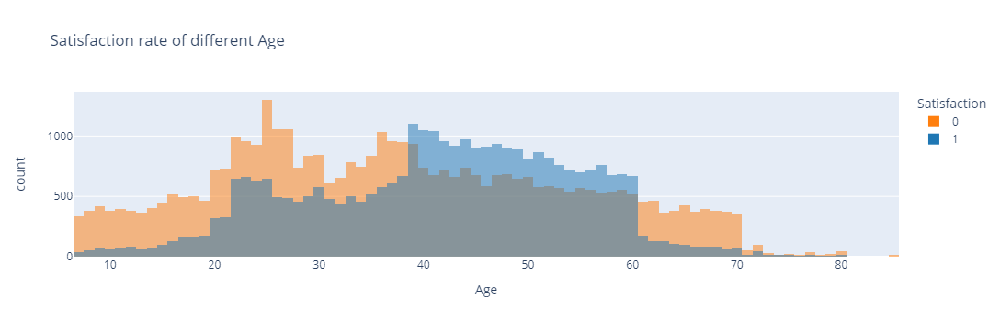

In [106]:
hist_age_satisfaction = px.histogram(df, 
                                     x='Age', 
                                     barmode='overlay', 
                                     color='satisfaction',
                                     labels={'satisfaction': 'Satisfaction'},
                                     title='Satisfaction rate of different Age',
                                     color_discrete_sequence=['#FF7F0E', '#1F77B4'])
hist_age_satisfaction.show()

> In the graph above, satisfaction is represented as follows:
> * **0 = neutral/disatisfied (orange)**
> * **1 = satisfied (blue)**

From the age distribution in terms of satisfaction rate, it is interesting to note that from the age of **39 - 60**, there are more people who are **satisfied**, while for all other age groups, the majority of the people are **unsatisfied**.

**However**, to **make a fair judgement**, before making a justification, it will be interesting to investigate if these people in the age of **39 - 60** are the majority who made up of the **loyal customers**, as from the previous analysis, loyal customers tend to express a higher possibility of being satisfied.

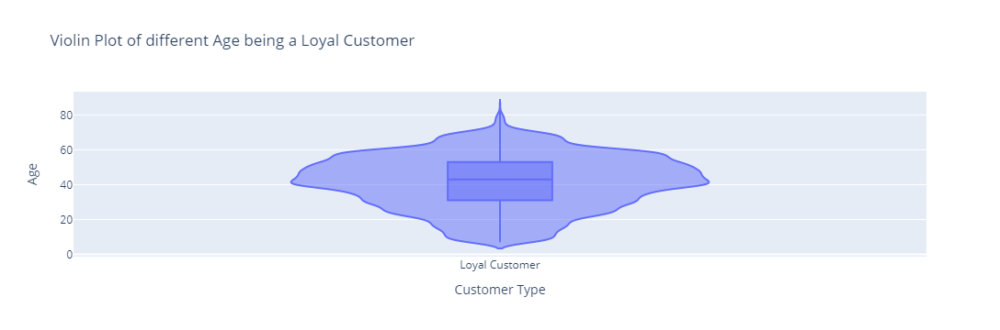

In [107]:
px.violin(df[df['Customer Type'] == 'Loyal Customer'], 
          x='Customer Type', 
          y='Age',
          title='Violin Plot of different Age being a Loyal Customer',
          box=True)

From the plot above, it can be seen that there are **more loyal customers** between the age group of **39 - 60**.

**However**, does it really is the **main reason** of people between the age of **39 - 60** being more satisfied, or is it just one of the reason?
* To further make a fair judgement, it will be interesting to see if these people are travelling under **different airline classes**.

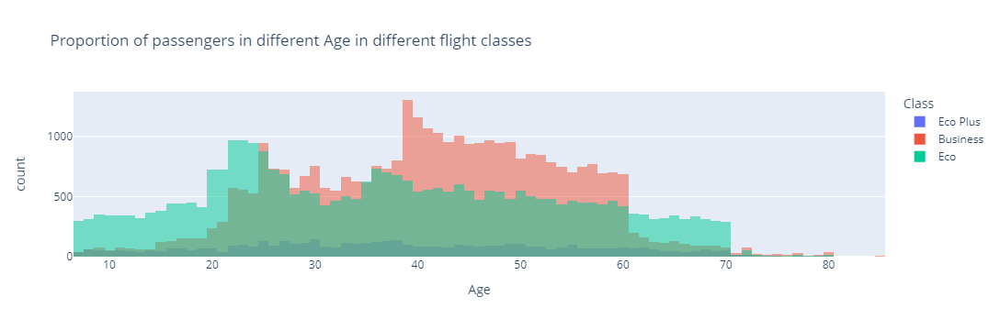

In [108]:
hist_age_class = px.histogram(df, 
                              x='Age', 
                              color='Class', 
                              barmode='overlay',
                              title='Proportion of passengers in different Age in different flight classes')
hist_age_class.show()

**For better visualization, let's put graphs side by side.**

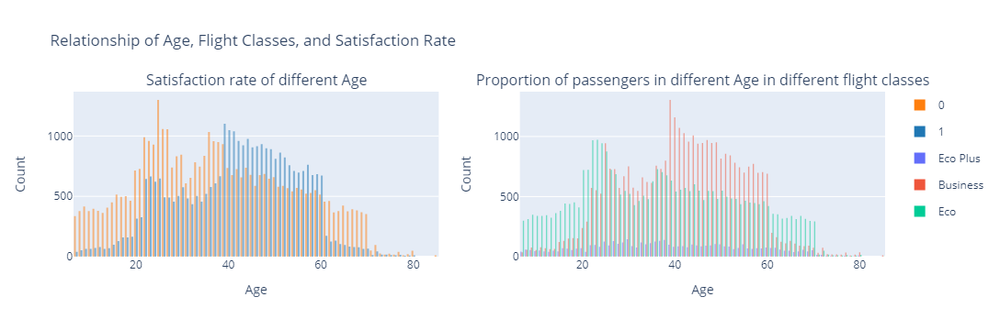

In [109]:
fig = make_subplots(rows=1, cols=2, subplot_titles=('Satisfaction rate of different Age', 'Proportion of passengers in different Age in different flight classes'))

fig.add_trace(hist_age_satisfaction.data[0], row=1, col=1)
fig.add_trace(hist_age_satisfaction.data[1], row=1, col=1)
fig.add_trace(hist_age_class.data[0], row=1, col=2)
fig.add_trace(hist_age_class.data[1], row=1, col=2)
fig.add_trace(hist_age_class.data[2], row=1, col=2)

fig.update_xaxes(title_text='Age', row=1, col=1)
fig.update_xaxes(title_text='Age', row=1, col=2)
fig.update_yaxes(title_text='Count', row=1, col=1)
fig.update_yaxes(title_text='Count', row=1, col=2)

fig.update_layout(title_text="Relationship of Age, Flight Classes, and Satisfaction Rate")
fig.show()

From the above plot, aside of more customers between the age of **39 - 60** are loyal customers, but more importantly, the majority of the passengers between this age group fly with **business class**.
* This will explain the dramatic difference of people in this age group being more satisfied.

To **further justify** the reasoning, it will also be important to take a look at how flying with **different classes** affect **satisfaction**.

In [110]:
# Make Confusion Matrix of Class and Satisfaction
class_cm = round(pd.crosstab(df['Class'], df['satisfaction'], normalize='index') * 100, 2)
class_cm

satisfaction,0,1
Class,,
Business,30.64,69.36
Eco,81.06,18.94
Eco Plus,74.78,25.22


**Class vs Satisfaction Visualization**

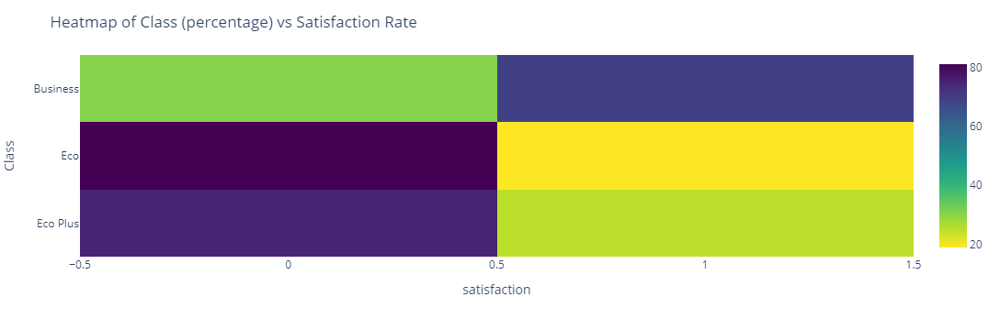

In [111]:
class_heatmap = px.imshow(class_cm, color_continuous_scale="Viridis_r")
class_heatmap.update_layout(title="Heatmap of Class (percentage) vs Satisfaction Rate")

From the heatmap, it is obvious that whether or not a person is flying with **business class** has a **huge impact** on whether the person is satisfied with the services provided.
* Thus, provides insights of people between the age group of **39 - 60** being drastically more satisfied.

> Combining with the previous analysis, aside of focusing on getting people to join the loyalty program, the company should also include deals that are related with the **flight class** such as having promotions of business class for frequent flyers, or at a discounted price from time to time.

<hr />

### Flight Distance and Satisfaction

A lot of times, the flight distance contributes to the comfort that the flight passengers will feel. Thus, it will also be another factor to be considered when analyzing the satisfaction rate.

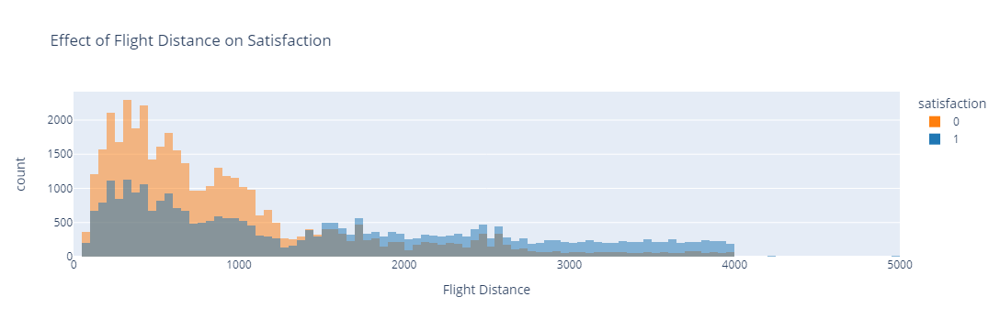

In [112]:
px.histogram(df, 
             x='Flight Distance',
             barmode='overlay',
             color='satisfaction',
             title='Effect of Flight Distance on Satisfaction',
             color_discrete_sequence=['#FF7F0E', '#1F77B4'])

By looking at the plot above, it can easily be seen that more people are experiencing neutral or disatisfaction for **flight with shorter distances (< 1250)**.
* This might be due to the passengers will experience more frequently in terms of the services provided by the flight company.
* As the flight distance increases, the satisfaction rate overtakes the disatisfaction rate.

**However**, it is again **too early to make a judgment** as before, which might lead to not having enough **ethical considerations / human factors**, and might cause **bias** in the data.

Therefore, other factors need to also be considered.

> As seen previously, **Class** has a **huge impact** in terms of satisfaction. It will be interesting to see if passengers from certain classes contribute mainly to the disatisfaction.

**Flight Class (Eco, Eco Plus, Business) and Flight Distance**

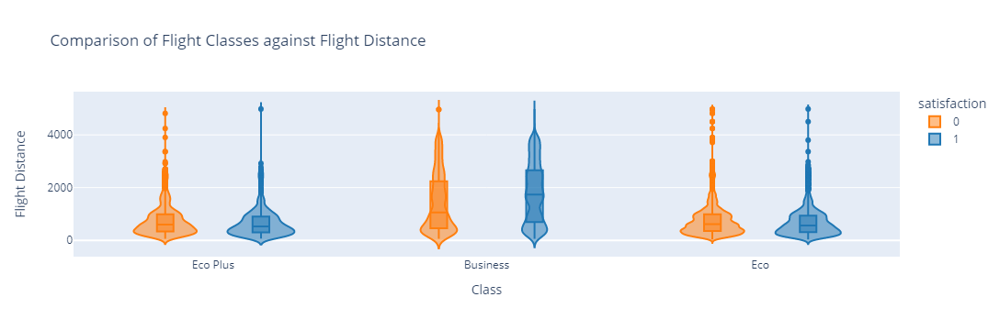

In [113]:
violin_class_dist = px.violin(df, 
                              y="Flight Distance", 
                              x="Class", 
                              color="satisfaction",
                              title='Comparison of Flight Classes against Flight Distance',
                              color_discrete_sequence=['#FF7F0E', '#1F77B4'],
                              box=True)
violin_class_dist.show()

By looking at the violin plot, people in **Eco** and **Eco Plus** made up the majority of the passengers for **flight distance < 2000**.

Also, as the flight distance increases, passengers in business class increase in terms of the passengers distribution.

To take a closer look at the class distribution and satisfaction, let's make a **detailed histogram**.

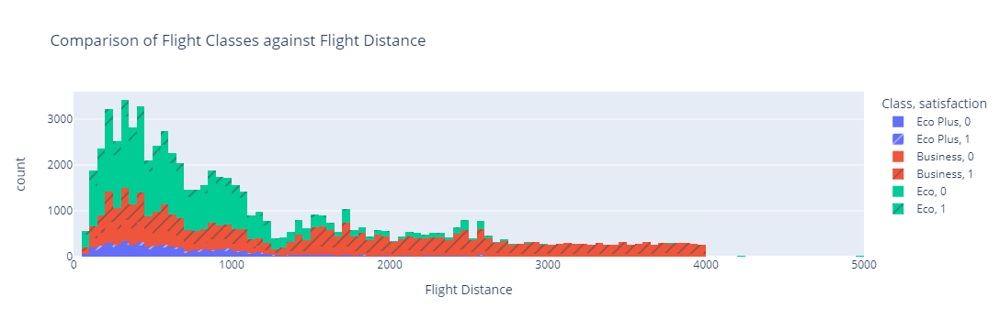

In [114]:
hist_class_dist = px.histogram(df, 
                               x='Flight Distance', 
                               color='Class', 
                               pattern_shape="satisfaction",
                               title='Comparison of Flight Classes against Flight Distance')
hist_class_dist.show()

With the detailed histogram, it can easily be determined that:
* The majority of the passengers are flying with **Eco**, and most people in the **Eco** class are neutral/unsatisfied.
* For people who are flying with **Business**, a much greater proportion of people are satisfied.

Without performing this further analysis, it can easily be assumed that shorter flight distance contributes to higher unsatisfaction with no logical reasoning, thus, making the analysis **more bias**.

By taking these factors into considerations, we can then see that for shorter flight distances, the **majority of the people are flying with Eco**, and they made up the majority of **unsatisfaction**.

<hr />

## Insights

<hr />

Ethical / Bias / Human Factors